In [27]:
import scanpy as sc
import pandas as pd
import seaborn as sns
import copy
import numpy as np
from matplotlib import pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [28]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80, facecolor='white')

-----
anndata     0.7.4
scanpy      1.6.0
sinfo       0.3.1
-----
PIL                 7.2.0
anndata             0.7.4
attr                20.1.0
backcall            0.2.0
cffi                1.14.2
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.1
decorator           4.4.2
future_fstrings     NA
get_version         2.1
google              NA
h5py                2.10.0
idna                2.10
igraph              0.8.2
importlib_metadata  1.7.0
ipykernel           5.3.4
ipython_genutils    0.2.0
jedi                0.17.2
jinja2              2.11.2
joblib              0.16.0
jsonschema          3.2.0
kiwisolver          1.2.0
legacy_api_wrap     1.2
leidenalg           0.8.1
llvmlite            0.34.0
louvain             0.7.0
markupsafe          1.1.1
matplotlib          3.3.1
mpl_toolkits        NA
natsort             7.0.1
nbformat            5.0.7
numba               0.51.0
numexpr             2.7.1
numpy               1.19.1
packaging           20.4
pandas

In [32]:
combined = sc.read('/scratch/PCA_decomposed_combined_samples.h5ad')

In [33]:
tests = []
for i in range(4):
    tests.append(copy.deepcopy(combined))

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:33)
running Leiden clustering
    finished: found 23 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:21)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:15)


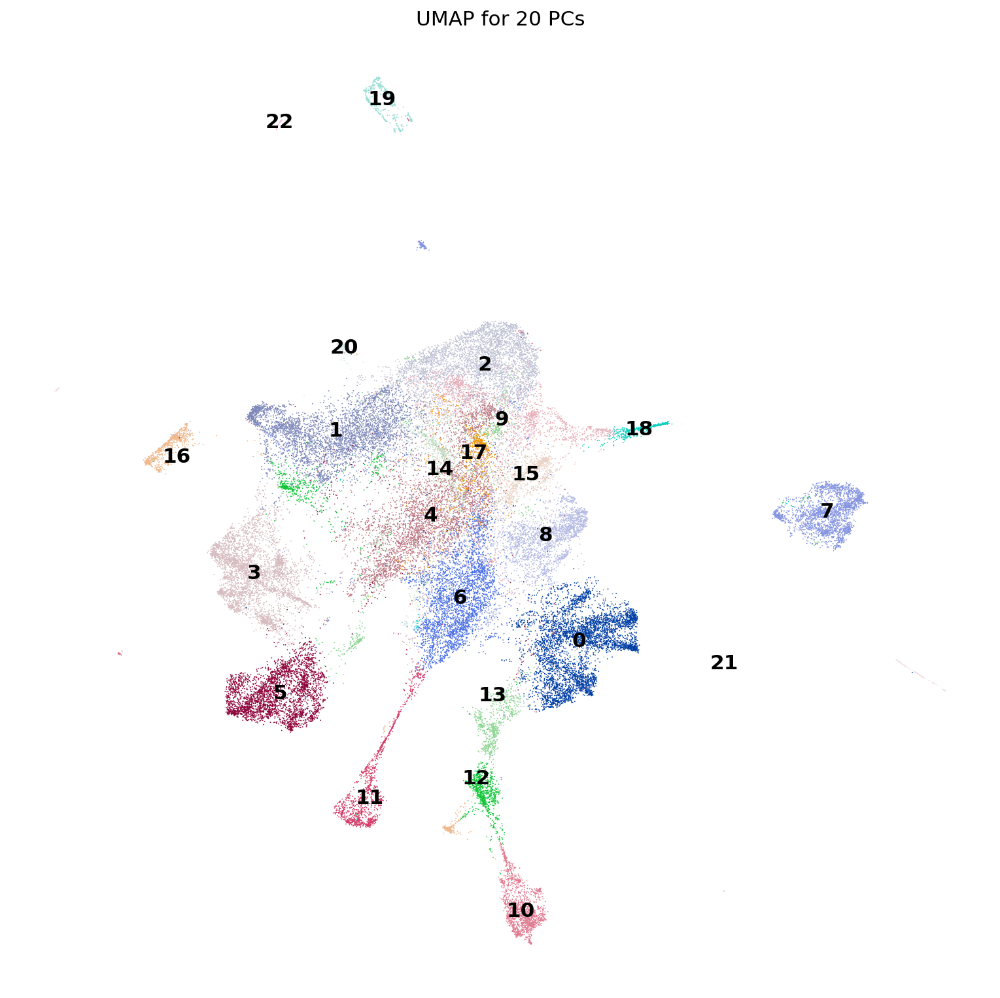

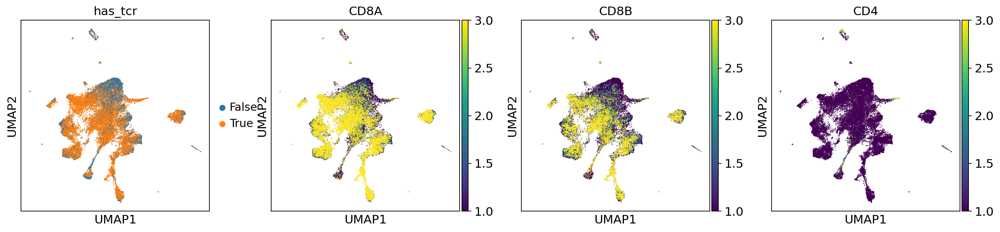

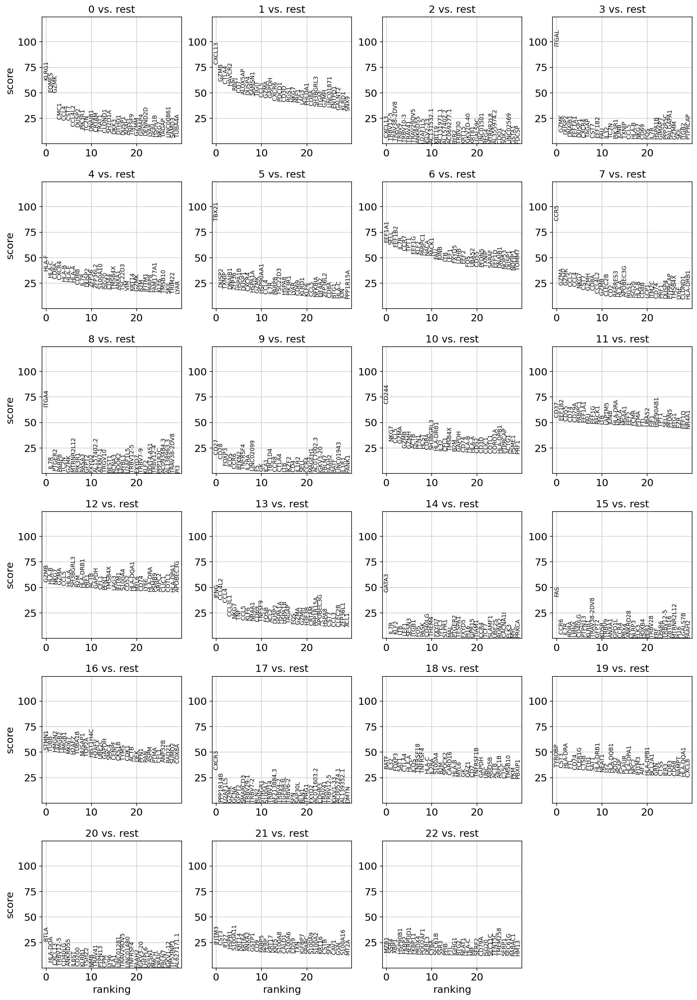

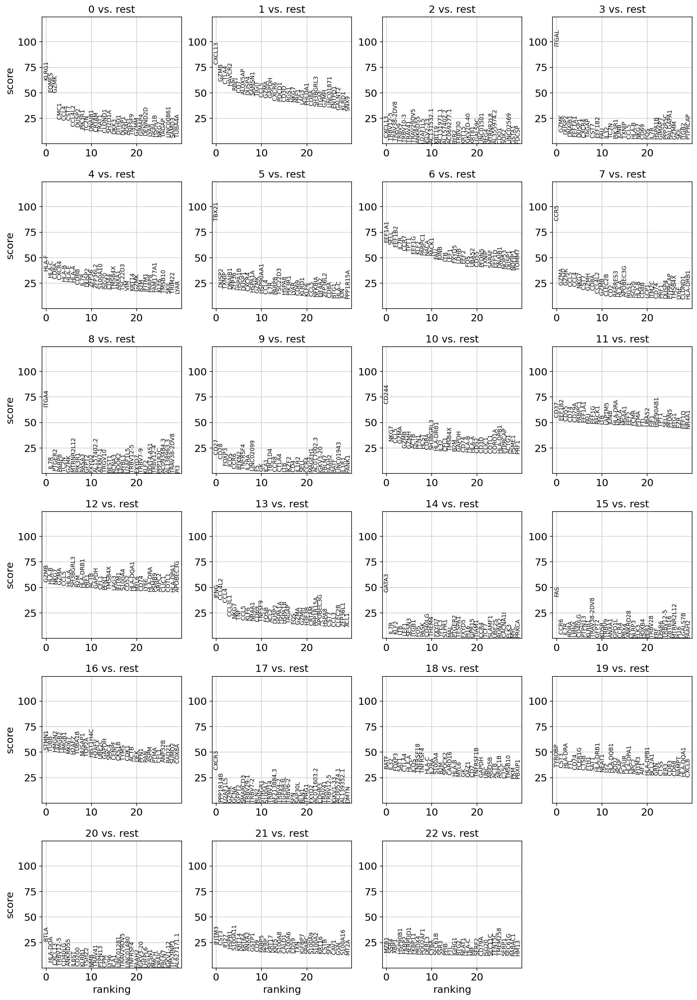

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:34)
running Leiden clustering
    finished: found 33 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:17)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:22)


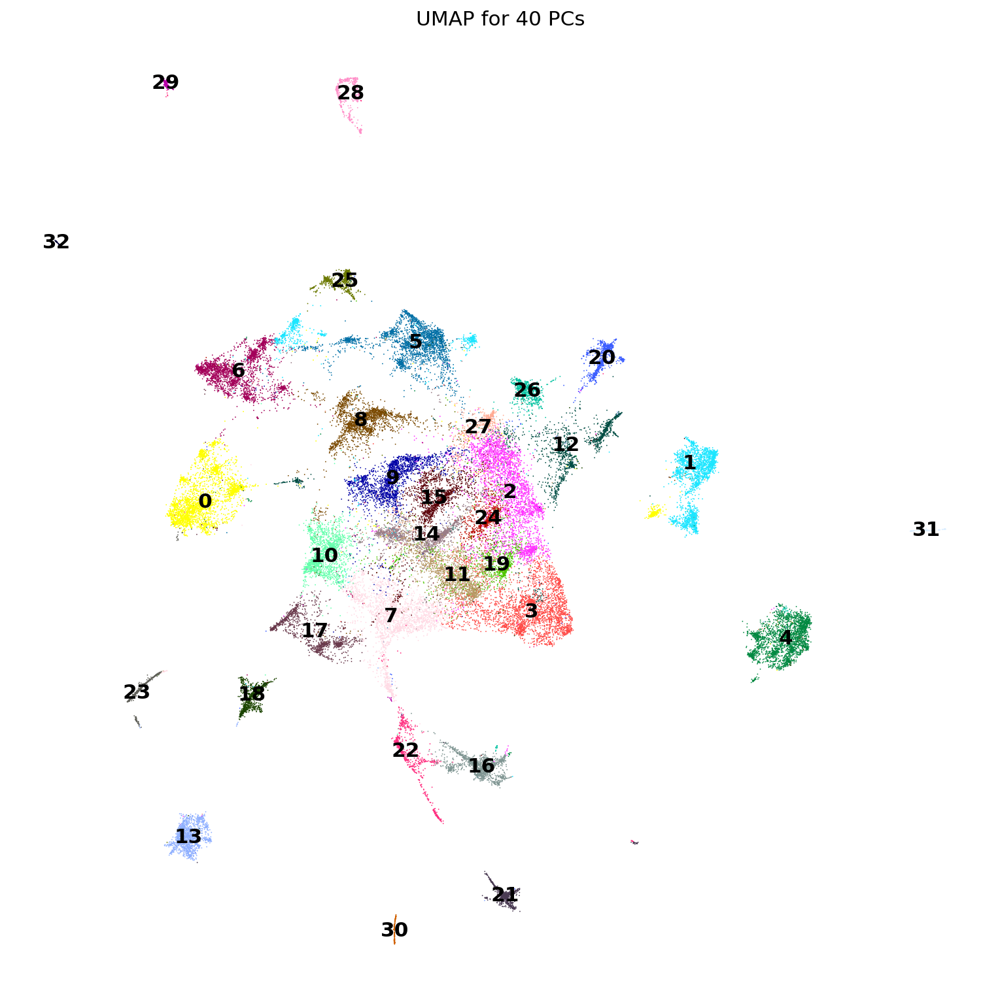

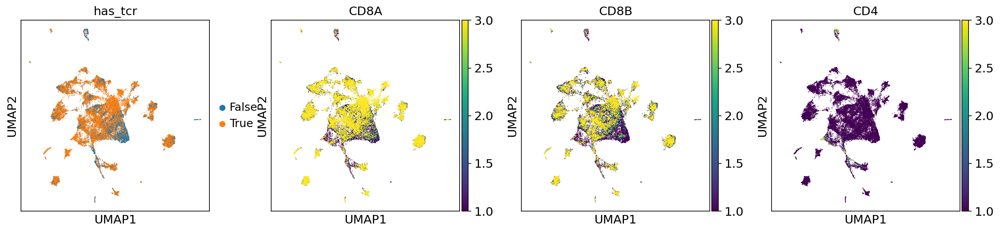

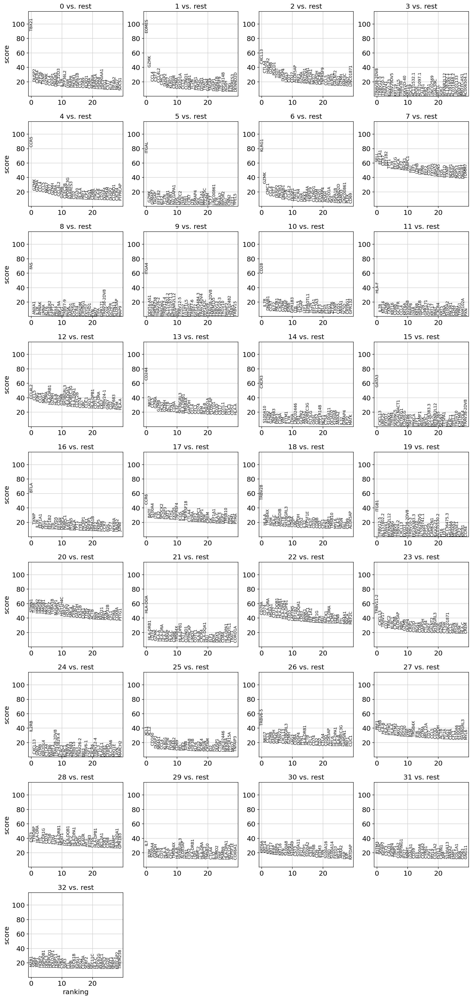

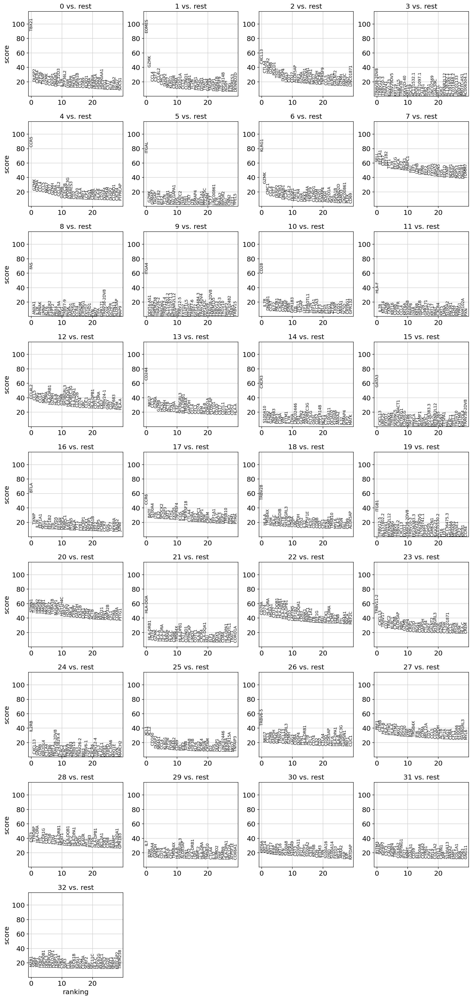

computing neighbors
    using 'X_pca' with n_pcs = 60
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:35)
running Leiden clustering
    finished: found 45 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:20)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:25)


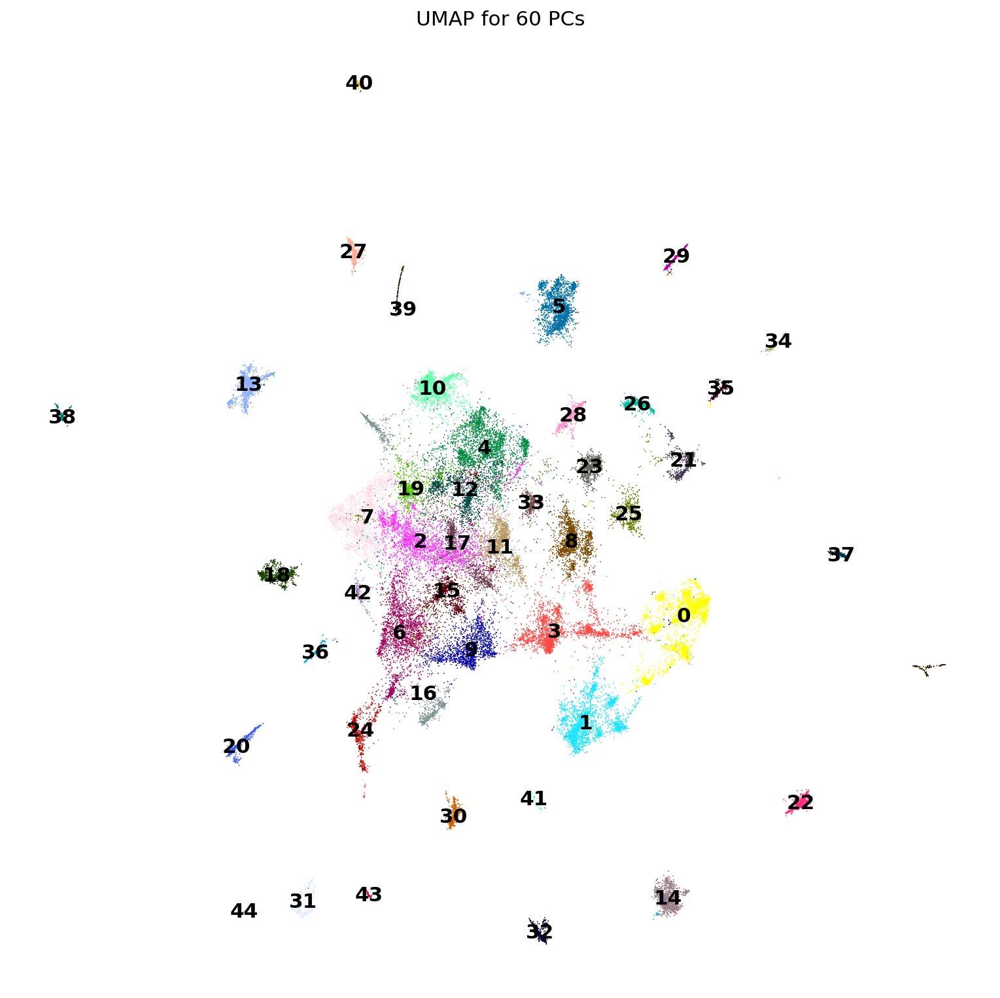

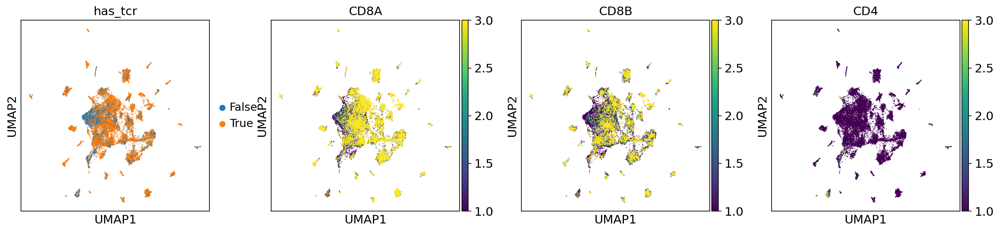

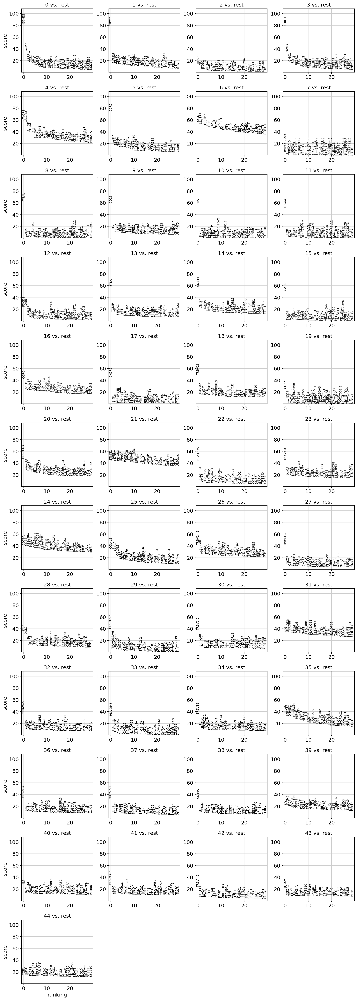

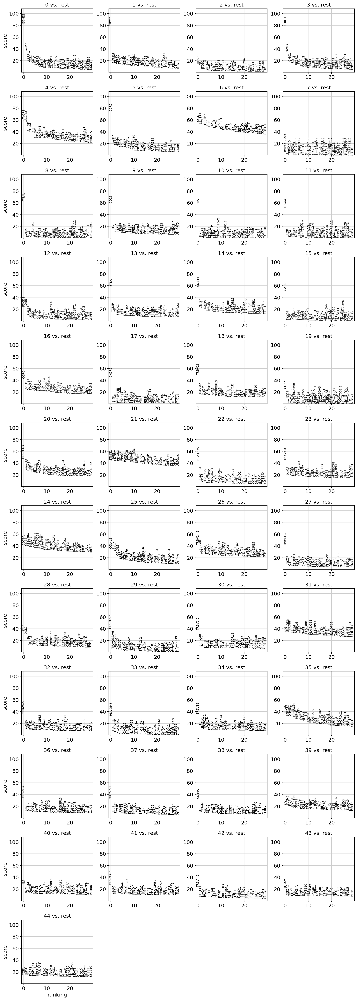

computing neighbors
    using 'X_pca' with n_pcs = 80
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:35)
running Leiden clustering
    finished: found 50 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:11)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:29)


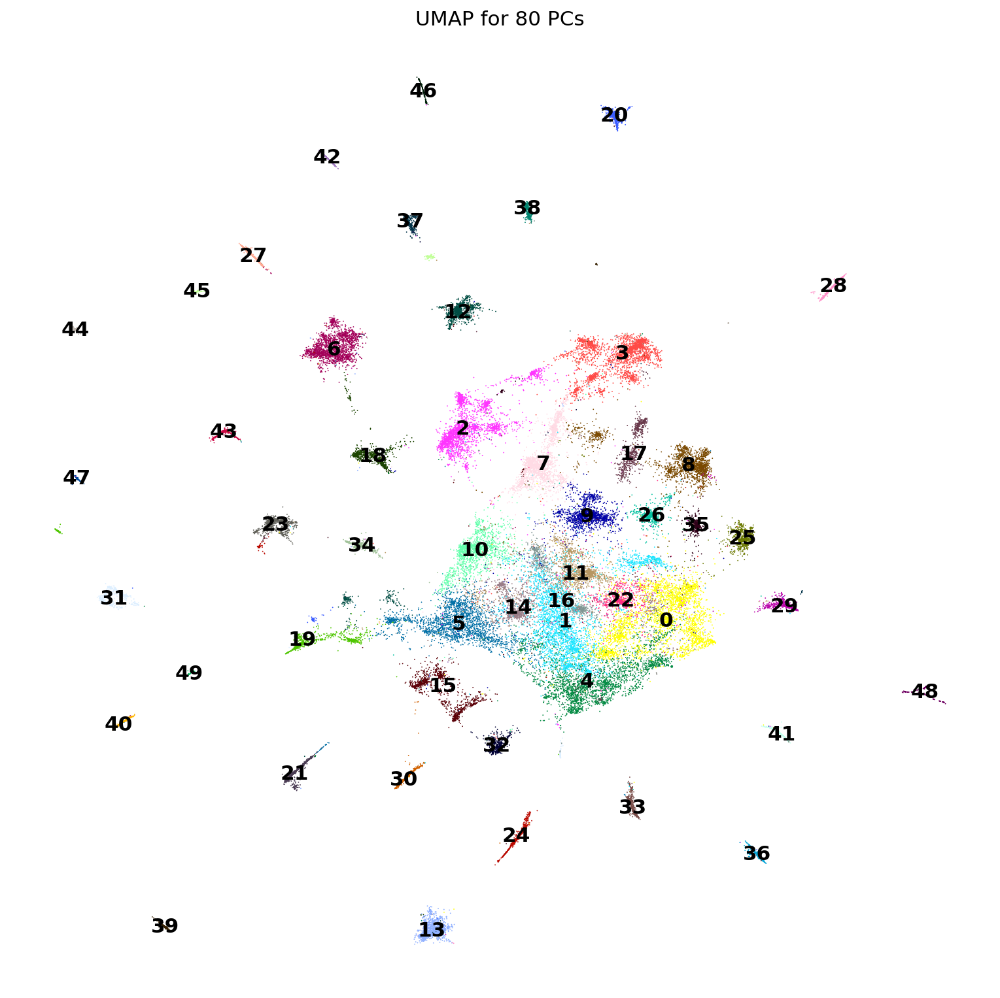

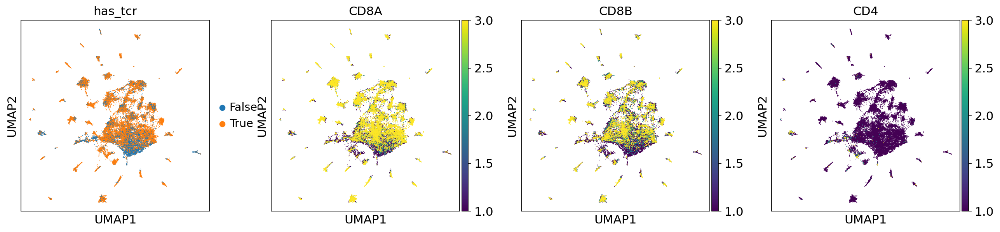

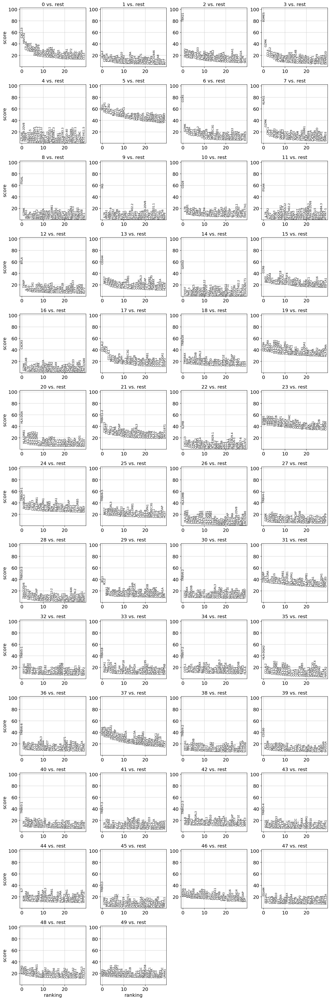

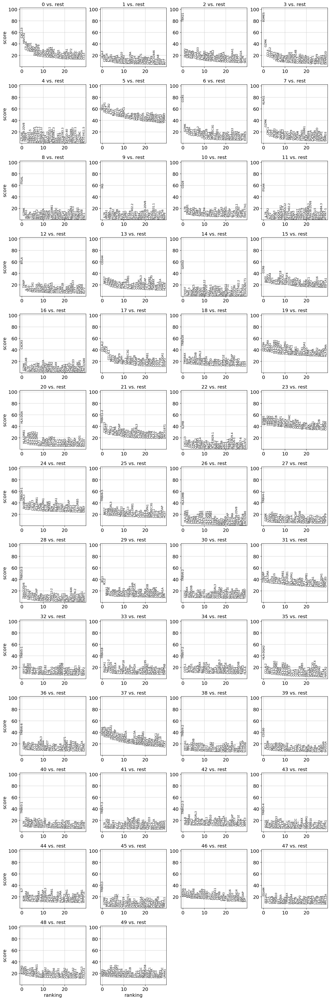

In [35]:
umaps = []
pc_used=[20,40,60,80]
for i in range(4):
    sc.pp.neighbors(tests[i], n_neighbors=10, n_pcs=pc_used[i])
    umaps.append(sc.tl.umap(tests[i], n_components=2, copy=True,min_dist=0.05))
    sc.tl.leiden(umaps[i])
    sc.tl.rank_genes_groups(umaps[-1], groupby='leiden',method='wilcoxon')
    
    fig, ax = plt.subplots(figsize=(12,12))
    sc.pl.umap(umaps[i], color='leiden', title='UMAP for '+str(pc_used[i])+' PCs', legend_loc='on data',frameon=False,ax=ax)
    sc.pl.umap(umaps[i],color=['has_tcr','CD8A','CD8B','CD4','CD19'],vmax=3,vmin=1)
    sc.pl.rank_genes_groups(umaps[i],n_genes=30,use_raw=True)
    sc.pl.rank_genes_groups(umaps[i],n_genes=30,use_raw=False)

In [38]:
for i in range(4):
    save_file='/scratch/test_PCs_'+str(i)+'.h5ad'
    umaps[i].write(save_file)

## Clustering splitting as a results of more PC being used

In [40]:
for i in range(4):
    tests[i] = copy.deepcopy(umaps[i])

In [46]:
PC_20_clustering = tests[0].obs['leiden']
PC_40_clustering = tests[1].obs['leiden']
PC_60_clustering = tests[2].obs['leiden']
PC_80_clustering = tests[3].obs['leiden']

In [58]:
for i in range(4):
    tests[i].obs['PC_20_clustering'] = PC_20_clustering
    tests[i].obs['PC_40_clustering'] = PC_40_clustering
    tests[i].obs['PC_60_clustering'] = PC_60_clustering
    tests[i].obs['PC_80_clustering'] = PC_80_clustering

#### Dividing into 40 clusters seems to be better than dividing into 20, since there are many clusters (0,8,10,12,14,16,18,21,25,26) that come from multiple sources. It means that with more PC the clustering algorithm is actually able to better aggregating cells with similarity instead of forcing splitting in the same cluster. 

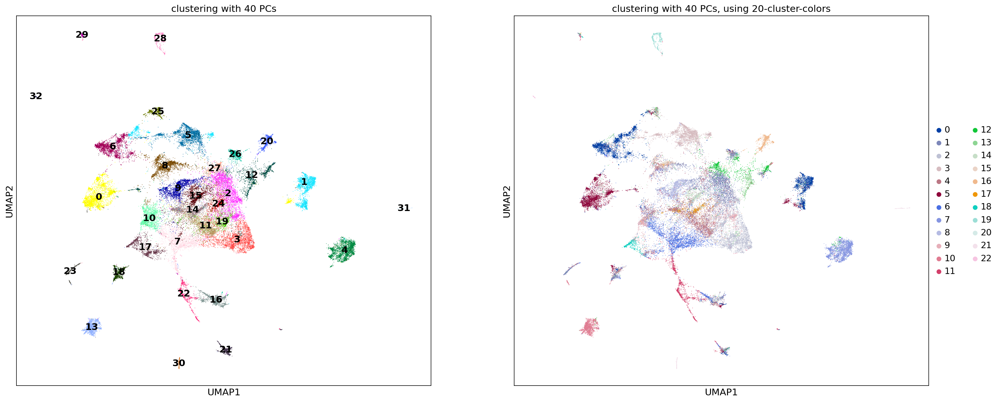

In [75]:
fig, (ax0, ax1) = plt.subplots(1, 2,sharex=True,gridspec_kw={'width_ratios': [2, 2]}, figsize=(24,10))
sc.pl.umap(tests[1],color='PC_40_clustering',title='clustering with 40 PCs',legend_loc='on data', ax=ax0,show=False)
sc.pl.umap(tests[1],color='PC_20_clustering',title='clustering with 40 PCs, using 20-cluster-colors', ax=ax1,show=False)
plt.show()

#### It looks like clustering with 60 PC is also an improvement of quality instead of unneeded statistical/technical splitting (see small clusters 26, 27, 28, 21, 25, 34, 30 and big clusters 2, 4, 12,17,19). 

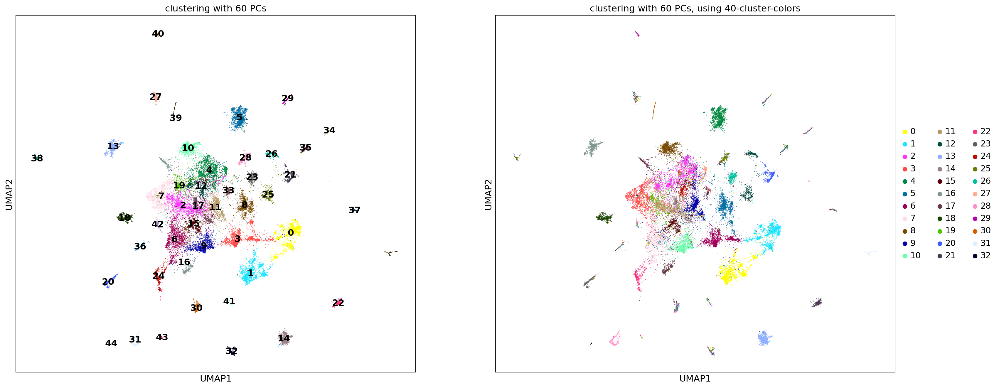

In [77]:
fig, (ax0, ax1) = plt.subplots(1, 2,sharex=True,gridspec_kw={'width_ratios': [2, 2]}, figsize=(24,10))
sc.pl.umap(tests[2],color='PC_60_clustering',title='clustering with 60 PCs',legend_loc='on data', ax=ax0,show=False)
sc.pl.umap(tests[2],color='PC_40_clustering',title='clustering with 60 PCs, using 40-cluster-colors', ax=ax1,show=False)
plt.show()

#### For the case of 80 PCs used, it does seem like we are forcing splitting as the major packs in the middle are stablized while almost all smaller packs have only one source.

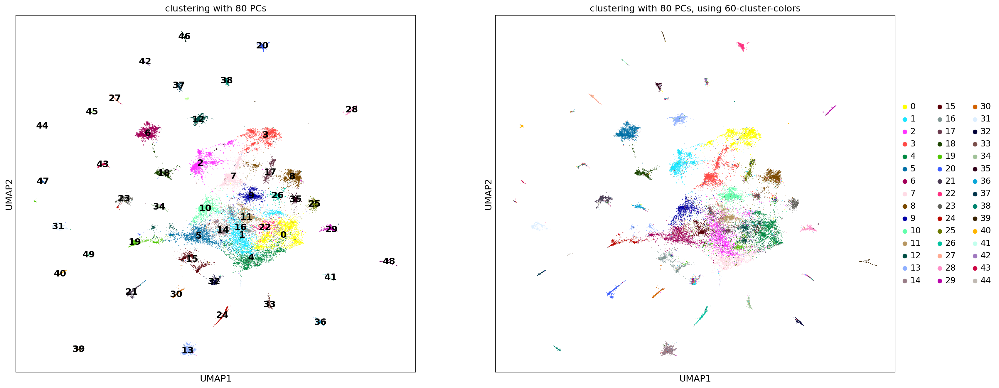

In [78]:
fig, (ax0, ax1) = plt.subplots(1, 2,sharex=True,gridspec_kw={'width_ratios': [2, 2]}, figsize=(24,10))
sc.pl.umap(tests[3],color='PC_80_clustering',title='clustering with 80 PCs',legend_loc='on data', ax=ax0,show=False)
sc.pl.umap(tests[3],color='PC_60_clustering',title='clustering with 80 PCs, using 60-cluster-colors', ax=ax1,show=False)
plt.show()